In [50]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Data and Problem Introduction

# To begin:

### Introduction

The healthcare sector continuously strives to enhance patient outcomes while optimizing operational efficiency. One critical aspect of hospital management is understanding and predicting the length of stay (LOS) for patients. Accurately predicting LOS helps in resource allocation, improving patient flow, and ensuring quality care. In our analysis, we explored various factors influencing the length of stay using a comprehensive dataset comprising patient demographics, hospital characteristics, admission details, and severity of illness. By leveraging advanced data science techniques, we aim to provide actionable insights that can drive strategic decisions and operational improvements.

### Objective

The primary objective of this project is to develop a predictive model for estimating the length of stay (LOS) for patients admitted to hospitals. Our goals are:

1. **Identify Key Predictors**: Determine the most significant factors that influence the length of stay, including patient demographics, hospital attributes, admission types, and severity of illness.
   
2. **Feature Engineering**: Transform and engineer features based on univariate and multivariate analyses to enhance model performance and interpretability.

3. **Model Development**: Train and evaluate various machine learning models, such as Random Forest, Gradient Boosting, and XGBoost, to predict the length of stay accurately.

4. **Interpretability**: Utilize SHAP (SHapley Additive exPlanations) values to interpret the model’s predictions and understand the impact of each feature on the length of stay.

5. **Operational Insights**: Provide actionable insights to stakeholders for optimizing resource allocation, improving patient flow, and enhancing overall hospital management.

By achieving these objectives, we aim to support hospital administrators in making data-driven decisions that lead to improved patient outcomes and more efficient use of healthcare resources.

# Data Prep

In [51]:
import pandas as pd

# Load and inspect the data
file_path = '/content/drive/MyDrive/UC Berkeley MA AI /capstone_project/data/healthcare/train_data.csv'
data = pd.read_csv(file_path)

# Display basic information about the dataset
data_info = data.info()

# Display the first few rows of the dataset
data_head = data.head()

data_info, data_head


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 318438 entries, 0 to 318437
Data columns (total 18 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   case_id                            318438 non-null  int64  
 1   Hospital_code                      318438 non-null  int64  
 2   Hospital_type_code                 318438 non-null  object 
 3   City_Code_Hospital                 318438 non-null  int64  
 4   Hospital_region_code               318438 non-null  object 
 5   Available Extra Rooms in Hospital  318438 non-null  int64  
 6   Department                         318438 non-null  object 
 7   Ward_Type                          318438 non-null  object 
 8   Ward_Facility_Code                 318438 non-null  object 
 9   Bed Grade                          318325 non-null  float64
 10  patientid                          318438 non-null  int64  
 11  City_Code_Patient                  3139

(None,
    case_id  Hospital_code Hospital_type_code  City_Code_Hospital  \
 0        1              8                  c                   3   
 1        2              2                  c                   5   
 2        3             10                  e                   1   
 3        4             26                  b                   2   
 4        5             26                  b                   2   
 
   Hospital_region_code  Available Extra Rooms in Hospital    Department  \
 0                    Z                                  3  radiotherapy   
 1                    Z                                  2  radiotherapy   
 2                    X                                  2    anesthesia   
 3                    Y                                  2  radiotherapy   
 4                    Y                                  2  radiotherapy   
 
   Ward_Type Ward_Facility_Code  Bed Grade  patientid  City_Code_Patient  \
 0         R                  F        2.0 

Initial Observations

- The dataset contains 18 columns and 31,844 rows.
- The target variable, Stay, represents the length of stay in discrete ranges (e.g., "0-10", "11-20").
- Several categorical features (e.g., Hospital_type_code, Department, Ward_Type) will need to be encoded for modeling.
- Some columns have missing values, such as Bed Grade and City_Code_Patient.

In [52]:
data.describe()


,case_id,Hospital_code,City_Code_Hospital,Available Extra Rooms in Hospital,Bed Grade,patientid,City_Code_Patient,Visitors with Patient,Admission_Deposit
count,318438.000000,318438.000000,318438.000000,318438.000000,318325.000000,318438.000000,313906.000000,318438.000000,318438.000000
mean,159219.500000,18.318841,4.771717,3.197627,2.625807,65747.579472,7.251859,3.284099,4880.749392
std,91925.276848,8.633755,3.102535,1.168171,0.873146,37979.936440,4.745266,1.764061,1086.776254
min,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1800.000000
25%,79610.250000,11.000000,2.000000,2.000000,2.000000,32847.000000,4.000000,2.000000,4186.000000
50%,159219.500000,19.000000,5.000000,3.000000,3.000000,65724.500000,8.000000,3.000000,4741.000000
75%,238828.750000,26.000000,7.000000,4.000000,3.000000,98470.000000,8.000000,4.000000,5409.000000
max,318438.000000,32.000000,13.000000,24.000000,4.000000,131624.000000,38.000000,32.000000,11008.000000



#### Key Insights

1. **Admission_Deposit**:
   - Mean: 4,880.75
   - Range: 1,800 to 11,008
   - Higher deposits are associated with longer stays.

2. **Visitors with Patient**:
   - Mean: 3.28
   - Range: 0 to 32
   - More visitors correlate with longer stays.

3. **Available Extra Rooms in Hospital**:
   - Mean: 3.20
   - Range: 0 to 24
   - Fewer available rooms correlate with longer stays.


## Dealing with missing values & Initial encoding

In [53]:
# Handle missing values
data['Bed Grade'].fillna(data['Bed Grade'].mode()[0], inplace=True)
data['City_Code_Patient'].fillna(data['City_Code_Patient'].mode()[0], inplace=True)

# Convert categorical variables using one-hot encoding
data_encoded = pd.get_dummies(data, columns=['Hospital_type_code', 'Hospital_region_code', 'Department', 'Ward_Type', 'Ward_Facility_Code', 'Type of Admission', 'Severity of Illness', 'Age'], drop_first=True)

# Convert 'Stay' to numerical format
stay_mapping = {
    '0-10': 5, '11-20': 15, '21-30': 25, '31-40': 35, '41-50': 45,
    '51-60': 55, '61-70': 65, '71-80': 75, '81-90': 85, '91-100': 95,
    'More than 100 Days': 110
}
data_encoded['Stay'] = data_encoded['Stay'].map(stay_mapping)

# Display the cleaned data
data_encoded.head()


,case_id,Hospital_code,City_Code_Hospital,Available Extra Rooms in Hospital,Bed Grade,patientid,City_Code_Patient,Visitors with Patient,Admission_Deposit,Stay,...,Severity of Illness_Moderate,Age_11-20,Age_21-30,Age_31-40,Age_41-50,Age_51-60,Age_61-70,Age_71-80,Age_81-90,Age_91-100
0,1,8,3,3,2.0,31397,7.0,2,4911.0,5,...,False,False,False,False,False,True,False,False,False,False
1,2,2,5,2,2.0,31397,7.0,2,5954.0,45,...,False,False,False,False,False,True,False,False,False,False
2,3,10,1,2,2.0,31397,7.0,2,4745.0,35,...,False,False,False,False,False,True,False,False,False,False
3,4,26,2,2,2.0,31397,7.0,2,7272.0,45,...,False,False,False,False,False,True,False,False,False,False
4,5,26,2,2,2.0,31397,7.0,2,5558.0,45,...,False,False,False,False,False,True,False,False,False,False


## Double check duplicate data


In [54]:
# Check for duplicates
duplicate_rows = data[data.duplicated()]
num_duplicates = duplicate_rows.shape[0]

num_duplicates, duplicate_rows.head()

(0,
 Empty DataFrame
 Columns: [case_id, Hospital_code, Hospital_type_code, City_Code_Hospital, Hospital_region_code, Available Extra Rooms in Hospital, Department, Ward_Type, Ward_Facility_Code, Bed Grade, patientid, City_Code_Patient, Type of Admission, Severity of Illness, Visitors with Patient, Age, Admission_Deposit, Stay]
 Index: [])

Great, no duplicate!


# Exploratory Data Analysis
### Univariate Numerical Analysis

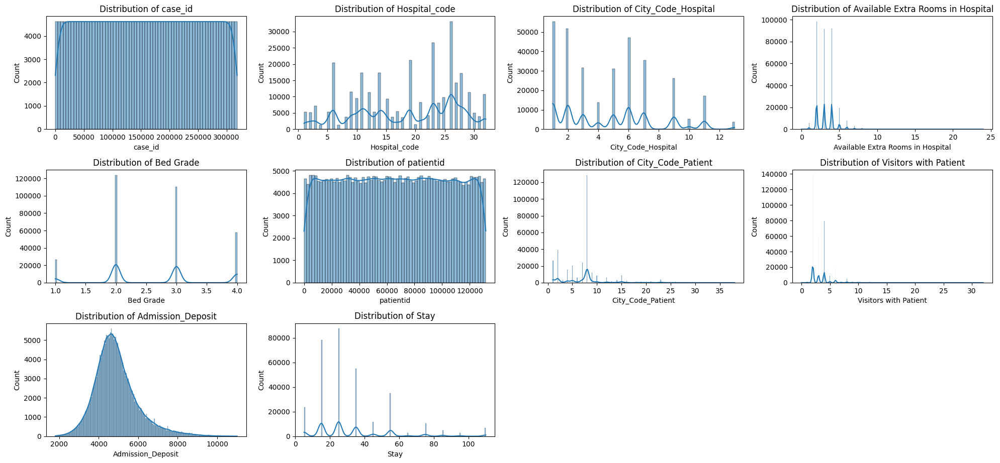

In [55]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set up the matplotlib figure
plt.figure(figsize=(20, 15))

# Plot distribution of numerical features
for i, column in enumerate(data_encoded.select_dtypes(include=['float64', 'int64']).columns, 1):
    plt.subplot(5, 4, i)
    sns.histplot(data_encoded[column], kde=True)
    plt.title(f'Distribution of {column}')

plt.tight_layout()
plt.show()


### Multivariates numerical analysis

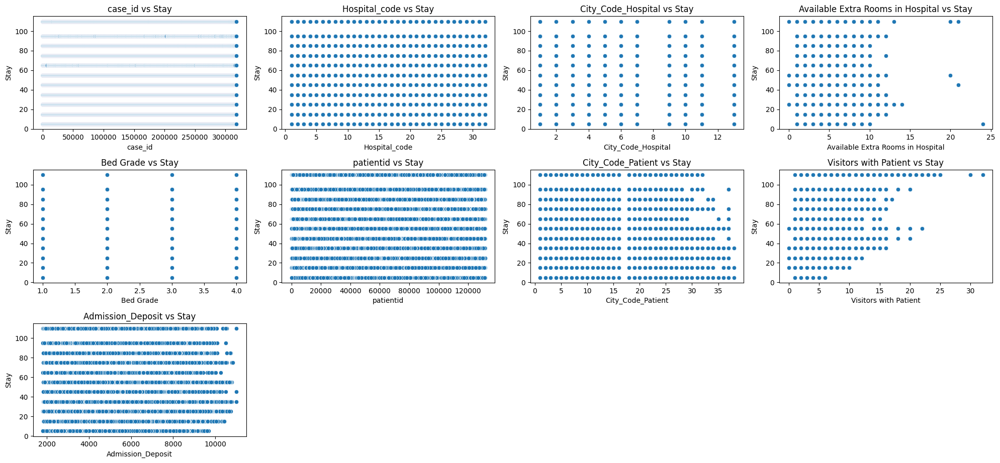

In [56]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set up the matplotlib figure
plt.figure(figsize=(20, 15))

# Plot relationships between numerical features and 'Stay'
for i, column in enumerate(data_encoded.select_dtypes(include=['float64', 'int64']).columns.drop('Stay'), 1):
    plt.subplot(5, 4, i)
    sns.scatterplot(x=data_encoded[column], y=data_encoded['Stay'])
    plt.title(f'{column} vs Stay')

plt.tight_layout()
plt.show()


### Univariate Categorical Analysis

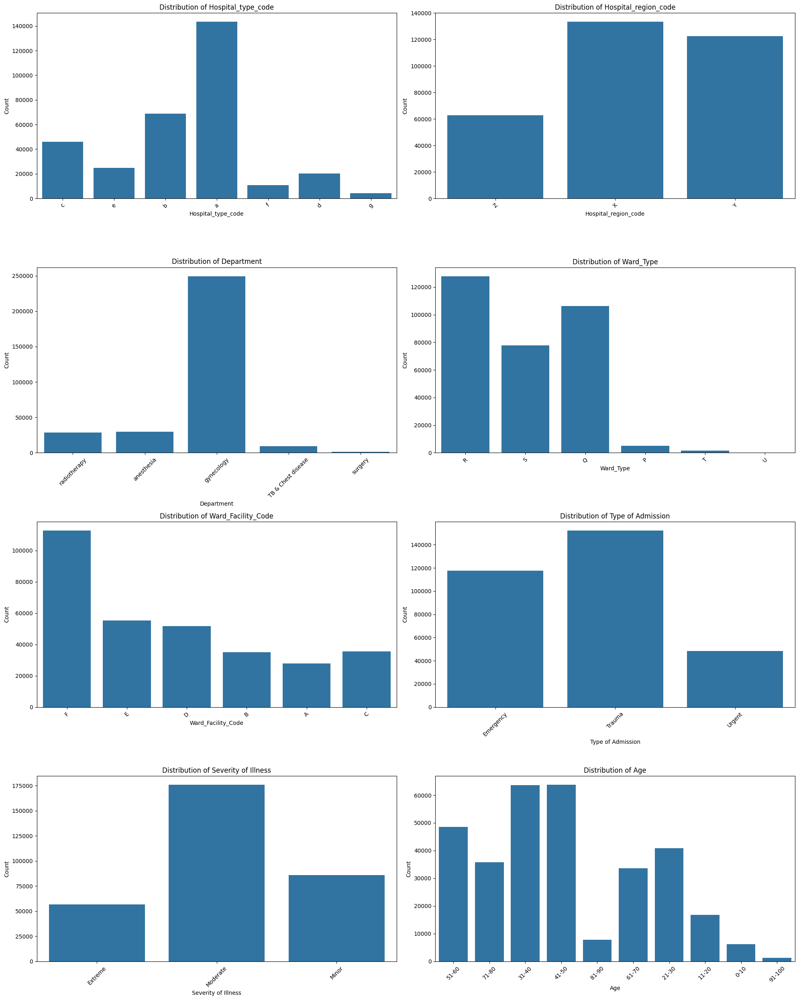

In [57]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of categorical columns to plot
categorical_columns = [
    'Hospital_type_code', 'Hospital_region_code', 'Department', 'Ward_Type',
    'Ward_Facility_Code', 'Type of Admission', 'Severity of Illness', 'Age'
]

# Plotting the distribution of categorical features
plt.figure(figsize=(20, 25))
for i, column in enumerate(categorical_columns, 1):
    plt.subplot(4, 2, i)
    sns.countplot(data=data, x=column)
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Count')
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


### Multivariate Categorical Analysis

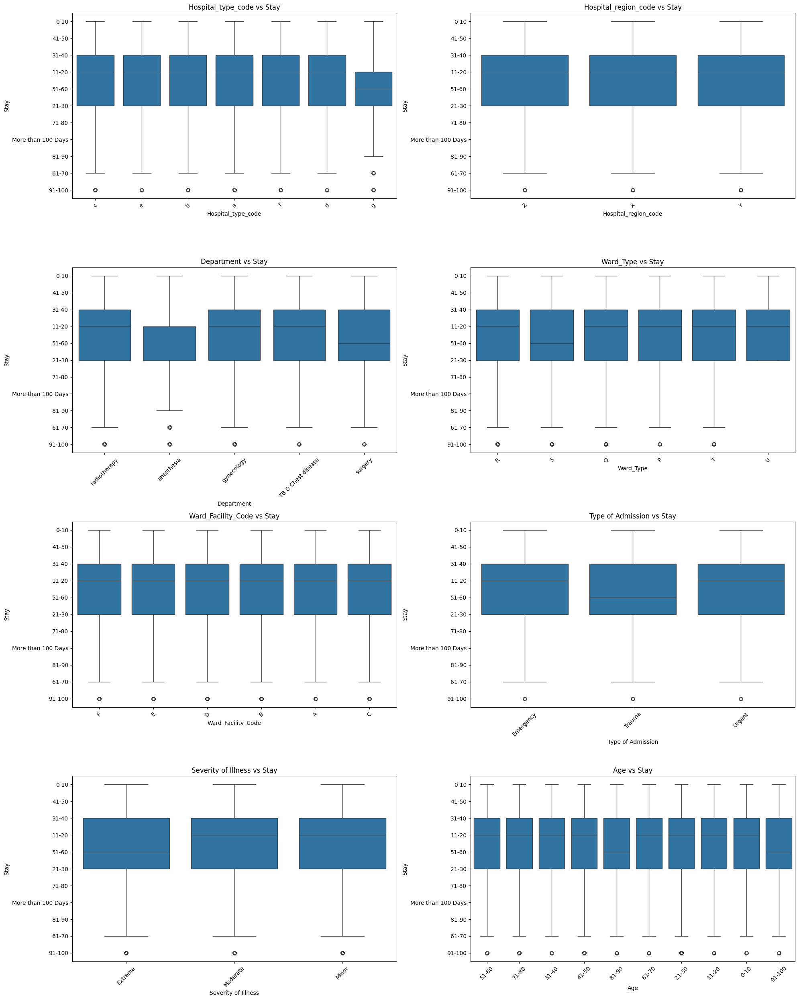

In [58]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of categorical columns to plot
categorical_columns = [
    'Hospital_type_code', 'Hospital_region_code', 'Department', 'Ward_Type',
    'Ward_Facility_Code', 'Type of Admission', 'Severity of Illness', 'Age'
]

# Plotting box plots for each categorical feature
plt.figure(figsize=(20, 25))
for i, column in enumerate(categorical_columns, 1):
    plt.subplot(4, 2, i)
    sns.boxplot(data=data, x=column, y='Stay')
    plt.title(f'{column} vs Stay')
    plt.xlabel(column)
    plt.ylabel('Stay')
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


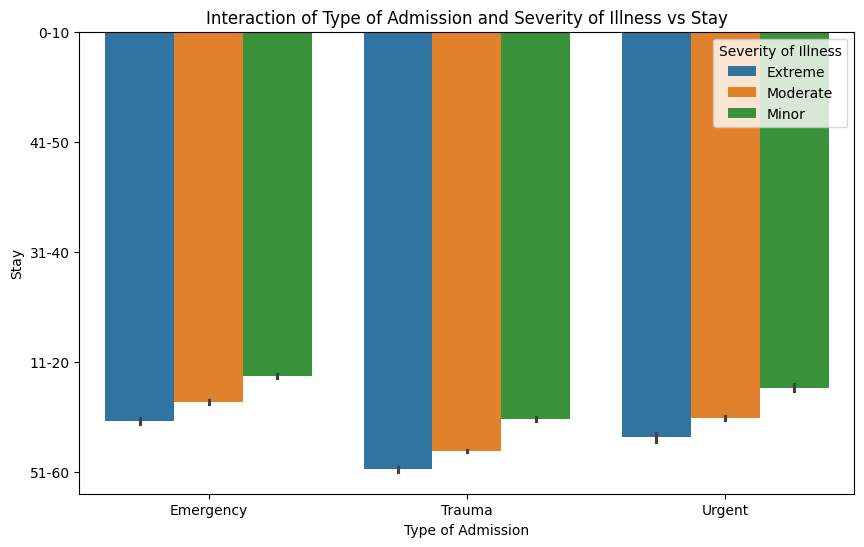

In [59]:
interaction_features = ['Type of Admission', 'Severity of Illness']

plt.figure(figsize=(10, 6))
sns.barplot(data=data, x=interaction_features[0], y='Stay', hue=interaction_features[1])
plt.title(f'Interaction of {interaction_features[0]} and {interaction_features[1]} vs Stay')
plt.xlabel(interaction_features[0])
plt.ylabel('Stay')
plt.legend(title=interaction_features[1])
plt.show()


### Correlation and Class Imbalance Analysis

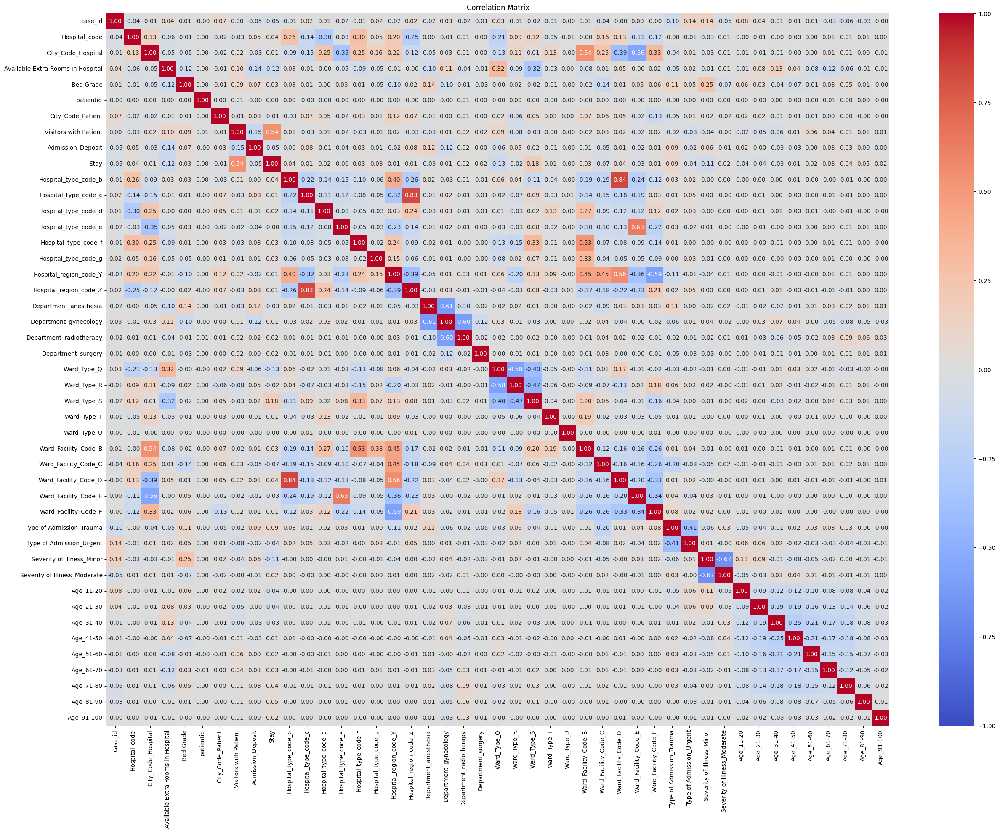

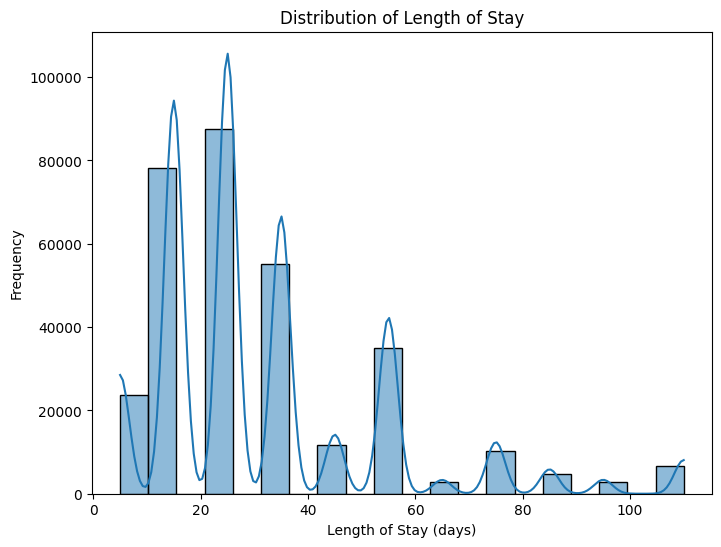

In [60]:
import seaborn as sns
import matplotlib.pyplot as plt

# Display descriptive statistics
data_encoded.describe()

# Correlation matrix
corr_matrix = data_encoded.corr()

# Plot correlation matrix
plt.figure(figsize=(30, 22))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()

# Plot distribution of the target variable (Stay)
plt.figure(figsize=(8, 6))
sns.histplot(data_encoded['Stay'], bins=20, kde=True)
plt.title('Distribution of Length of Stay')
plt.xlabel('Length of Stay (days)')
plt.ylabel('Frequency')
plt.show()


## Distribution Analysis

#### Numerical Features

1. **Admission_Deposit**:
   - Shows a broad spread with higher admission deposits somewhat associated with longer stays.
   - Transformations like logarithmic scaling or handling outliers might improve model performance.
   - ![Distribution of Admission_Deposit](images/image.png)

2. **Visitors with Patient**:
   - Higher numbers of visitors are associated with longer stays.
   - This feature has a right-skewed distribution, suggesting it might benefit from transformation.

3. **Available Extra Rooms in Hospital**:
   - Hospitals with fewer available extra rooms tend to have longer stays.
   - Indicates potential resource constraints impacting patient length of stay.

#### Categorical Features

1. **Severity of Illness**:
   - Patients with 'Extreme' severity have the highest median length of stay, followed by 'Moderate' and 'Minor'.
   - This feature is a strong predictor and should be included prominently in the model.

2. **Type of Admission**:
   - 'Trauma' admissions generally result in higher stays compared to 'Urgent' and 'Emergency' admissions.
   - Interaction with `Severity of Illness` is significant and should be considered.

3. **Age**:
   - Younger age groups have slightly lower median lengths of stay, with the median length increasing gradually with age.
   - This feature can capture demographic differences in healthcare needs.

4. **Hospital Characteristics**:
   - `Hospital_type_code`, `Hospital_region_code`, and `Ward_Type` show some variation in length of stay distributions.
   - These features might capture differences in hospital practices and regional healthcare delivery.

### Interaction Effects

1. **Type of Admission and Severity of Illness**:
   - This interaction shows notable differences in length of stay and should be included in the model, potentially as interaction terms.

## Correlation Analysis

### General Correlation Analysis

The correlation matrix reveals key relationships between features:

- **Admission_Deposit**: Moderately positively correlated with length of stay (Stay), indicating higher deposits are linked to longer stays.
- **Available Extra Rooms in Hospital**: Negatively correlated with length of stay, suggesting fewer available rooms result in longer stays.
- **Visitors with Patient**: Slight positive correlation with length of stay, meaning more visitors are associated with longer stays.

Other notable correlations:
- **City_Code_Hospital** and **City_Code_Patient**: Strong positive correlation, indicating patients tend to visit hospitals in their city code.
- **Hospital_type_code** and **Ward_Type**: Moderate positive correlation, suggesting certain hospital types have specific ward types.


### PCA & Clustering

Optimal n_component and n_cluster:

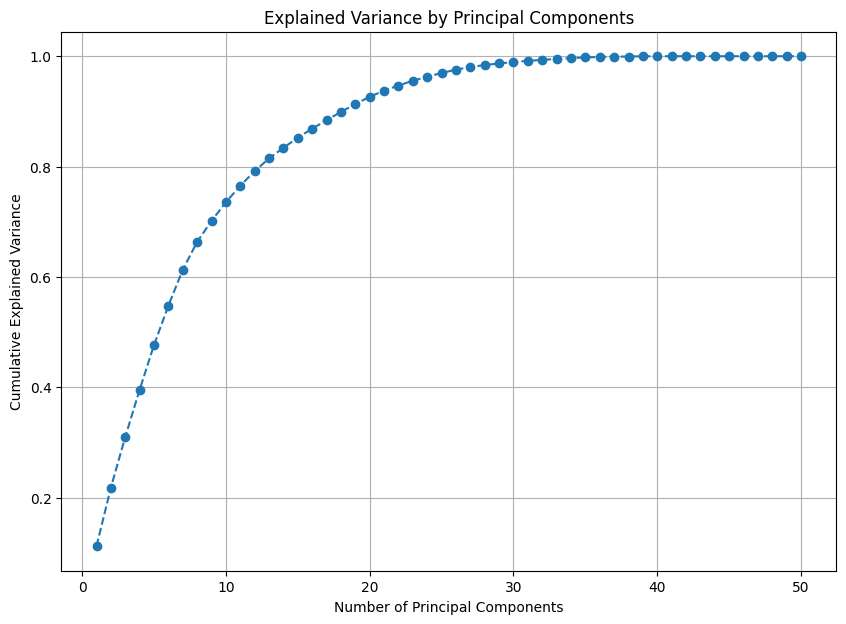

In [61]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import numpy as np

# Data Preprocessing
# Identify categorical and numerical columns
categorical_cols = [
    'Hospital_type_code', 'Hospital_region_code', 'Department',
    'Ward_Type', 'Ward_Facility_Code', 'Type of Admission',
    'Severity of Illness', 'Age'
]
numerical_cols = [
    'Hospital_code', 'City_Code_Hospital', 'Available Extra Rooms in Hospital',
    'Bed Grade', 'City_Code_Patient', 'Visitors with Patient', 'Admission_Deposit'
]

# Create preprocessing pipelines for numerical and categorical data
numerical_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Combine preprocessing steps
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_cols),
        ('cat', categorical_transformer, categorical_cols)
    ]
)

# Apply preprocessing
data_preprocessed = preprocessor.fit_transform(data)

# Function to calculate the optimal number of PCA components using explained variance
def plot_pca_variance_explained(data):
    pca = PCA().fit(data)
    explained_variance = np.cumsum(pca.explained_variance_ratio_)
    plt.figure(figsize=(10, 7))
    plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o', linestyle='--')
    plt.title('Explained Variance by Principal Components')
    plt.xlabel('Number of Principal Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.grid(True)
    plt.show()

# Plot the explained variance to determine the optimal number of PCA components
plot_pca_variance_explained(data_preprocessed)




From the plot:

  - At 15 principal components, the cumulative explained variance is about 90%.
  - At 25 principal components, the cumulative explained variance is about 95%.

20 n_component should be reasonaly balance

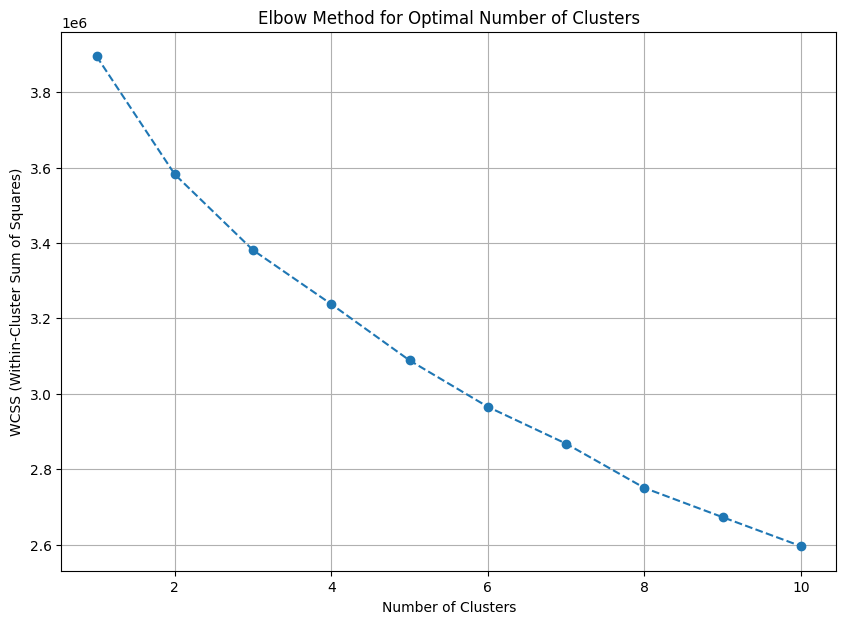

In [62]:
# Function to plot the elbow plot for K-means clustering
def plot_elbow_method(data, max_clusters=10):
    wcss = []
    for i in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=i, random_state=42, n_init='auto')
        kmeans.fit(data)
        wcss.append(kmeans.inertia_)

    plt.figure(figsize=(10, 7))
    plt.plot(range(1, max_clusters + 1), wcss, marker='o', linestyle='--')
    plt.title('Elbow Method for Optimal Number of Clusters')
    plt.xlabel('Number of Clusters')
    plt.ylabel('WCSS (Within-Cluster Sum of Squares)')
    plt.grid(True)
    plt.show()

# Plot the elbow method to determine the optimal number of clusters
plot_elbow_method(data_preprocessed)

It seems to me that after 4 it start to slow down, let's go with 4

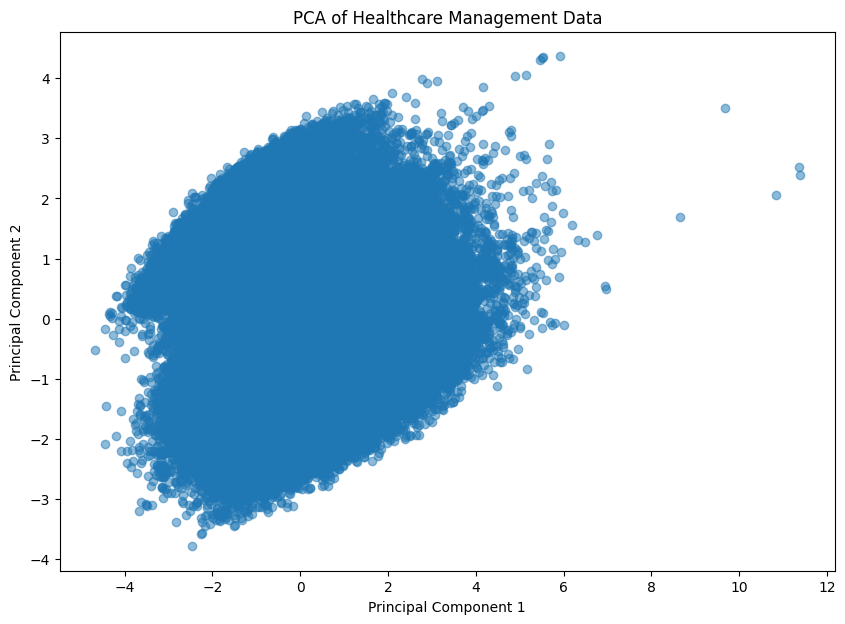

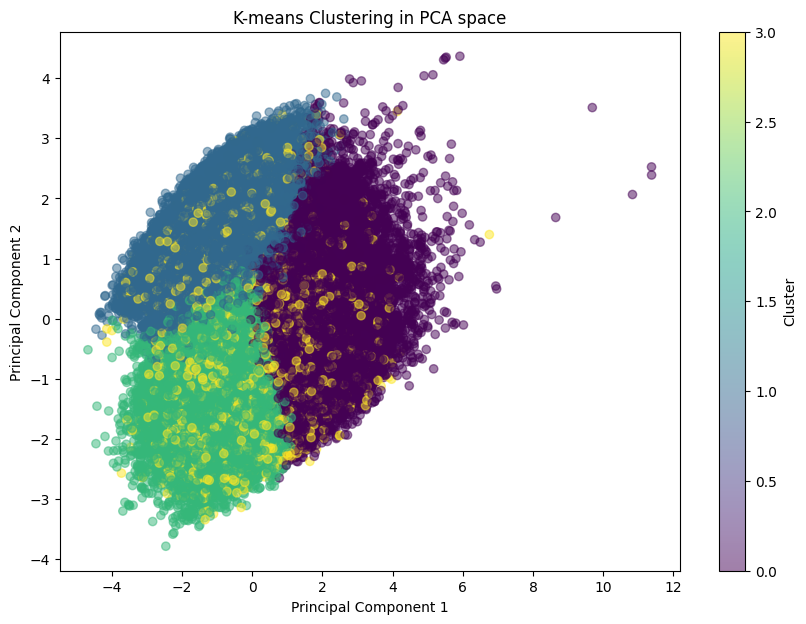

In [63]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np



# PCA
pca = PCA(n_components=20)
pca_result = pca.fit_transform(data_preprocessed)

# Visualize PCA results
plt.figure(figsize=(10, 7))
plt.scatter(pca_result[:, 0], pca_result[:, 1], alpha=0.5)
plt.title('PCA of Healthcare Management Data')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

# Clustering
kmeans = KMeans(n_clusters=4, random_state=42, n_init='auto')
clusters = kmeans.fit_predict(data_preprocessed)

# Visualize clusters in PCA space
plt.figure(figsize=(10, 7))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=clusters, cmap='viridis', alpha=0.5)
plt.title('K-means Clustering in PCA space')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Cluster')
plt.show()


Observing the characteristics ofr each cluster based on the mean or median values of the features.

In [64]:
# creating a columns
data['Cluster'] = clusters

# Separate numerical and categorical columns
numerical_columns = data.select_dtypes(include=[np.number]).columns.tolist()
categorical_columns = data.select_dtypes(include=[object]).columns.tolist()

# Calculate the mean for numerical columns
cluster_numerical_profile = data.groupby('Cluster')[numerical_columns].mean()

# Calculate the mode for categorical columns
cluster_categorical_profile = data.groupby('Cluster')[categorical_columns].agg(lambda x: x.mode().iloc[0])

# Combine numerical and categorical profiles
cluster_profile = pd.concat([cluster_numerical_profile, cluster_categorical_profile], axis=1)

# Display the cluster profiles
cluster_profile


,case_id,Hospital_code,City_Code_Hospital,Available Extra Rooms in Hospital,Bed Grade,patientid,City_Code_Patient,Visitors with Patient,Admission_Deposit,Cluster,Hospital_type_code,Hospital_region_code,Department,Ward_Type,Ward_Facility_Code,Type of Admission,Severity of Illness,Age,Stay
Cluster,,,,,,,,,,,,,,,,,,,
0,163167.700934,14.735553,3.866332,4.154895,2.412814,65805.763740,5.880304,4.027164,4334.308567,0.0,a,X,gynecology,Q,F,Trauma,Moderate,31-40,21-30
1,154094.040587,22.121347,8.759784,2.906732,2.482348,65834.725786,6.915580,3.188414,4851.933164,1.0,a,Y,gynecology,R,B,Emergency,Moderate,41-50,11-20
2,155278.219226,18.739421,2.877617,2.628502,2.894332,65556.321940,6.158009,2.781234,5342.185762,2.0,a,X,gynecology,R,F,Trauma,Moderate,31-40,21-30
3,180275.865019,17.440830,4.010348,3.194751,2.639555,66153.790430,19.236723,3.137630,4879.205720,3.0,a,X,gynecology,R,F,Trauma,Moderate,41-50,21-30


### Comprehensive Cluster Profiles

### Key Observations
- **Cluster 0:** Hospitals with higher available extra rooms and a younger patient age range (31-40), primarily dealing with trauma cases.
- **Cluster 1:** Hospitals in region Y with older patients (41-50) dealing with emergency cases, fewer extra rooms, and moderately lower admission deposits.
- **Cluster 2:** Hospitals in region X with moderate extra rooms and younger patients (31-40) primarily dealing with trauma cases.
- **Cluster 3:** Hospitals with the highest patient IDs and city code patients, moderate extra rooms, dealing with trauma cases for older patients (41-50).

Now I am curious if these observation has any correlation between them

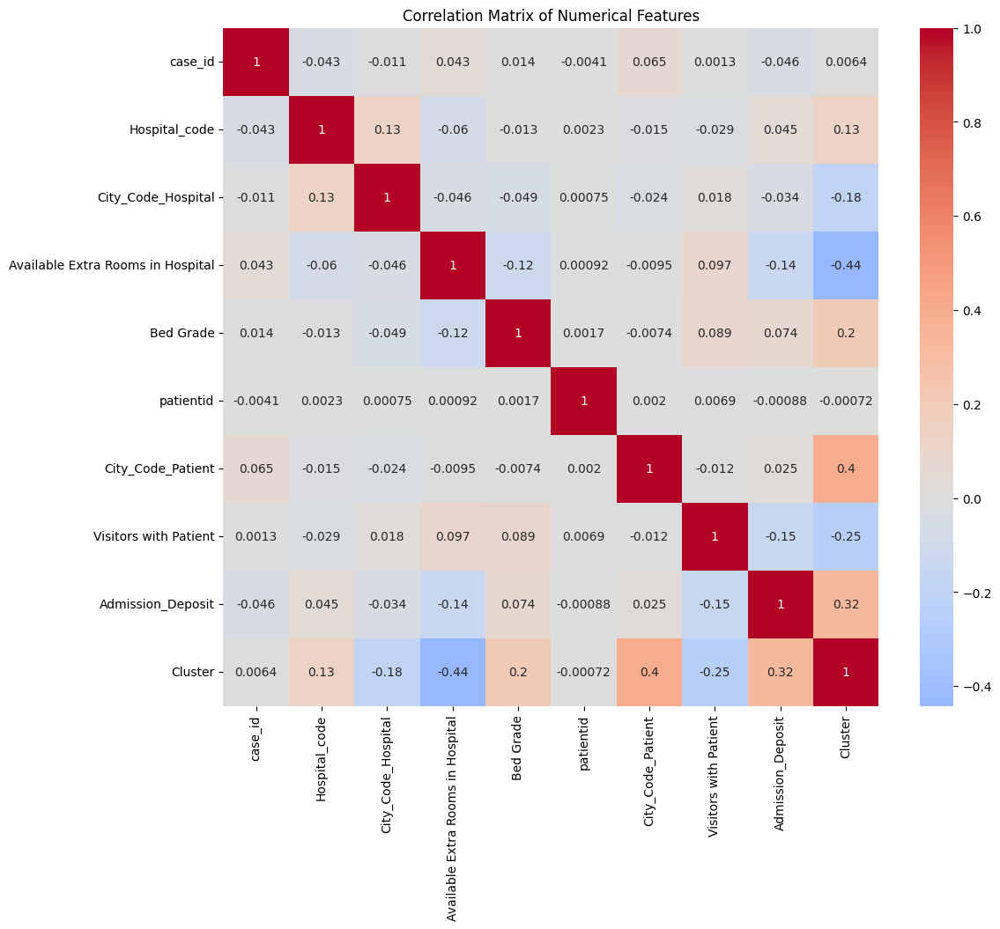

In [65]:
# Calculate the correlation matrix for numerical features
correlation_matrix = data[numerical_columns].corr()

# Visualize the correlation matrix using a heatmap
import seaborn as sns
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix of Numerical Features')
plt.show()


### Correlation Analysis

What I have noticed:
1. **Negative Correlations:**
   - **Cluster vs. Available Extra Rooms in Hospital (-0.44):** Strong negative correlation indicating that the cluster assignment is significantly influenced by the number of extra rooms available in the hospital.
   - **Cluster vs. Visitors with Patient (-0.25):** Moderate negative correlation indicating that clusters with fewer visitors are distinguished from those with more visitors.

2. **Positive Correlations:**
   - **Cluster vs. Admission Deposit (0.32):** Moderate positive correlation indicating that clusters are somewhat differentiated by the admission deposits.
   - **Cluster vs. City Code Patient (0.40):** Strong positive correlation suggesting that the city code of patients is a significant factor in cluster assignments.
   - **Hospital Code vs. City Code Hospital (0.13):** Slight positive correlation indicating some relationship between hospital codes and city codes.
   - **Visitors with Patient vs. Available Extra Rooms in Hospital (0.097):** Weak positive correlation indicating a slight tendency for hospitals with more extra rooms to have more visitors.

3. **Other Observations:**
   - The correlation between features is generally low, indicating weak linear relationships between most of the numerical features.
   - The cluster feature shows meaningful correlations with several other features, indicating that these features play a significant role in defining the clusters.

### Key Insights
- **Cluster and Available Extra Rooms in Hospital:** The number of available extra rooms is a key differentiating factor between clusters.
- **Cluster and Visitors with Patient:** The number of visitors is also an important factor, with some clusters having significantly fewer visitors.
- **Cluster and Admission Deposit:** The admission deposit amount helps differentiate between clusters.
- **Cluster and City Code Patient:** The city code of patients significantly influences cluster assignment, suggesting geographical or demographic patterns.



## 3D PCA Plot

In [66]:
import plotly.express as px

pca = PCA(n_components=20)
data_reduced = pca.fit_transform(data_preprocessed)

# Add PCA components to the original data with clusters
data['PCA1'] = data_reduced[:, 0]
data['PCA2'] = data_reduced[:, 1]
data['PCA3'] = data_reduced[:, 2]

# Second code snippet
fig_3d = px.scatter_3d(
    data, x='PCA1', y='PCA2', z='PCA3', color='Cluster',
    title='3D K-means Clustering in PCA space',
    labels={'PCA1': 'Principal Component 1', 'PCA2': 'Principal Component 2', 'PCA3': 'Principal Component 3'}
)
fig_3d.show()

# Moving Forward:
### Feature Engineering

1. **One-Hot Encoding**:
   - Encode categorical features using one-hot encoding to create binary columns for each category.

2. **Interaction Terms**:
   - Create interaction terms for significant combinations, such as `Type of Admission` and `Severity of Illness`.

3. **Normalization/Transformation**:
   - Apply transformations to numerical features like `Admission_Deposit` and `Visitors with Patient` to handle skewness and outliers.

### Predictive Modeling Strategy

1. **Model Selection**:
   - Use ensemble methods like Random Forest, Gradient Boosting, and XGBoost, which can handle interactions and non-linear relationships effectively.

2. **Model Evaluation**:
   - Evaluate model performance using metrics such as Mean Absolute Error (MAE), Mean Squared Error (MSE), and R-squared.
   - Cross-validation should be used to ensure the robustness of the model.

3. **Interpretability**:
   - Even we have not covered SHAP in this course but I suggest to use SHAP (SHapley Additive exPlanations) to understand feature importance and the impact of each feature on predictions.
   - Utilize Partial Dependence Plots (PDPs) to visualize the effect of individual features on the predicted outcome, holding other features constant.
   - This will help in making the model interpretable and actionable.

###Recommendation System
Overview

To further enhance patient care and support hospital management, a recommendation system can be developed to recommend the best hospital, region, and department for a new patient based on their current severity and condition. This system can also predict the expected length of stay by recommend which type of hospitals and wards, which location (rural or urban), which department, base on the patient severity of illness, age, income, etc. These would be helping patients prepare mentally for their treatment duration.

### Implementation Steps

1. **Data Preparation**:
   - Apply necessary transformations and encoding.
   - Split the dataset into training and testing sets.

2. **Model Training**:
   - Train models using Random Forest, Gradient Boosting, XGBoost and deep neural network (MLPs, RNNs, LSTMs, etc).
   - Optimize hyperparameters using grid search or random search.

3. **Model Evaluation**:
   - Evaluate the models on the testing set.
   - Use SHAP and PDPs to interpret the results and understand feature importance.

4. **Model Deployment**:
   - Choose the best-performing model based on evaluation metrics.
   - Deploy the model and monitor its performance over time.